We start with a cleaned, imputed and merged dataset from the original raw data sets from which now in this notebook we will generate new features (Feature Engineering) to bring the data and the features to the Provider level where our Fraud flag (Target feature) is at.  We also encode and aggregate the data during feature engineering. Then we start modeling.  

In [1]:
import numpy as np
import pandas as pd
%matplotlib inline 
import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
import sklearn.model_selection as ms
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, roc_auc_score, recall_score

train_patient_data = pd.read_csv('./train_patient_data.csv', index_col=0)
Train = pd.read_csv('./data/Train.csv', index_col=0)

C:\Users\oyb50\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (5) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [2]:
train_patient_data.head()

,BeneID,ClaimID,Provider,ClmAdmitDiagnosisCode,DiagnosisGroupCode,AdmissionDuration,ClaimDuration,Total_ClmDiagnosisCode,Total_ClmProcedureCode,RenalDiseaseIndicator,...,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,Total_ChronicCond,TotalClaimCost,PatientType,Total_Physician
0,BENE11001,CLM46614,PRV55912,7866,201,7.0,7,9,0,0.0,...,1,36000,3204,60,70,67,7,3867.0,1,1
1,BENE11001,CLM66048,PRV55907,6186,750,3.0,3,3,1,0.0,...,1,36000,3204,60,70,67,7,2023.0,1,2
2,BENE11001,CLM68358,PRV56046,29590,883,4.0,4,6,0,0.0,...,1,36000,3204,60,70,67,7,1517.0,1,2
3,BENE11011,CLM38412,PRV52405,431,067,9.0,9,9,1,0.0,...,1,5000,1068,250,320,96,6,674.0,1,3
4,BENE11014,CLM63689,PRV56614,78321,975,18.0,18,9,1,1.0,...,0,21260,2136,120,100,72,6,615.0,1,2


In [3]:
train_patient_data.columns

Index(['BeneID', 'ClaimID', 'Provider', 'ClmAdmitDiagnosisCode',
       'DiagnosisGroupCode', 'AdmissionDuration', 'ClaimDuration',
       'Total_ClmDiagnosisCode', 'Total_ClmProcedureCode',
       'RenalDiseaseIndicator', 'State', 'County', 'ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke',
       'IPAnnualReimbursementAmt', 'IPAnnualDeductibleAmt',
       'OPAnnualReimbursementAmt', 'OPAnnualDeductibleAmt', 'Age',
       'Total_ChronicCond', 'TotalClaimCost', 'PatientType',
       'Total_Physician'],
      dtype='object')

In [4]:
train_patient_data = train_patient_data.drop(columns=['IPAnnualReimbursementAmt', 'IPAnnualDeductibleAmt', 'OPAnnualReimbursementAmt','OPAnnualDeductibleAmt'])

In [5]:
train_patient_data.AdmissionDuration = train_patient_data.AdmissionDuration.fillna(1)

In [6]:
train_patient_data.AdmissionDuration.isnull().sum()

0

In [7]:
pd.set_option('display.max_rows', train_patient_data.shape[0]+1)

train_patient_data.isna().sum()

BeneID                                  0
ClaimID                                 0
Provider                                0
ClmAdmitDiagnosisCode              412312
DiagnosisGroupCode                 517737
AdmissionDuration                       0
ClaimDuration                           0
Total_ClmDiagnosisCode                  0
Total_ClmProcedureCode                  0
RenalDiseaseIndicator                   0
State                                   0
County                                  0
ChronicCond_Alzheimer                   0
ChronicCond_Heartfailure                0
ChronicCond_KidneyDisease               0
ChronicCond_Cancer                      0
ChronicCond_ObstrPulmonary              0
ChronicCond_Depression                  0
ChronicCond_Diabetes                    0
ChronicCond_IschemicHeart               0
ChronicCond_Osteoporasis                0
ChronicCond_rheumatoidarthritis         0
ChronicCond_stroke                      0
Age                               

In [8]:
train_patient_data.loc[train_patient_data['BeneID']=='BENE11004']

,BeneID,ClaimID,Provider,ClmAdmitDiagnosisCode,DiagnosisGroupCode,AdmissionDuration,ClaimDuration,Total_ClmDiagnosisCode,Total_ClmProcedureCode,RenalDiseaseIndicator,...,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,Age,Total_ChronicCond,TotalClaimCost,PatientType,Total_Physician
40477,BENE11004,CLM121801,PRV56011,NaN,NaN,1.0,1,1,0,0.0,...,1,1,1,1,0,88,6,40.0,0,1
40478,BENE11004,CLM150998,PRV56011,71947,NaN,1.0,1,6,0,0.0,...,1,1,1,1,0,88,6,200.0,0,1
40479,BENE11004,CLM173224,PRV56011,NaN,NaN,1.0,1,1,0,0.0,...,1,1,1,1,0,88,6,20.0,0,1
40480,BENE11004,CLM224741,PRV56011,NaN,NaN,1.0,1,4,0,0.0,...,1,1,1,1,0,88,6,40.0,0,1
40481,BENE11004,CLM252512,PRV56011,NaN,NaN,1.0,1,4,0,0.0,...,1,1,1,1,0,88,6,200.0,0,2
40482,BENE11004,CLM322683,PRV56011,NaN,NaN,1.0,21,9,0,0.0,...,1,1,1,1,0,88,6,60.0,0,2
40483,BENE11004,CLM339500,PRV56011,NaN,NaN,1.0,13,1,0,0.0,...,1,1,1,1,0,88,6,500.0,0,2
40484,BENE11004,CLM529356,PRV55951,NaN,NaN,1.0,1,2,0,0.0,...,1,1,1,1,0,88,6,60.0,0,2
40485,BENE11004,CLM564511,PRV56011,99811,NaN,1.0,1,4,0,0.0,...,1,1,1,1,0,88,6,400.0,0,1
40486,BENE11004,CLM627730,PRV55903,NaN,NaN,1.0,1,2,0,0.0,...,1,1,1,1,0,88,6,90.0,0,2


In [9]:
train_patient_data['Age_bins'] = pd.cut(x=train_patient_data['Age'], bins=[25, 29, 39, 49, 59, 69, 79, 89, 102], labels=['20-30', '30-40', '40-50', '50-60', '60-70', '70-80', '80-90', '90-101'])

In [10]:
train_patient_data['Age_bins'].isnull().sum()

0

In [11]:
train_patient_data.head()

,BeneID,ClaimID,Provider,ClmAdmitDiagnosisCode,DiagnosisGroupCode,AdmissionDuration,ClaimDuration,Total_ClmDiagnosisCode,Total_ClmProcedureCode,RenalDiseaseIndicator,...,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,Age,Total_ChronicCond,TotalClaimCost,PatientType,Total_Physician,Age_bins
0,BENE11001,CLM46614,PRV55912,7866,201,7.0,7,9,0,0.0,...,1,0,1,1,67,7,3867.0,1,1,60-70
1,BENE11001,CLM66048,PRV55907,6186,750,3.0,3,3,1,0.0,...,1,0,1,1,67,7,2023.0,1,2,60-70
2,BENE11001,CLM68358,PRV56046,29590,883,4.0,4,6,0,0.0,...,1,0,1,1,67,7,1517.0,1,2,60-70
3,BENE11011,CLM38412,PRV52405,431,067,9.0,9,9,1,0.0,...,0,0,1,1,96,6,674.0,1,3,90-101
4,BENE11014,CLM63689,PRV56614,78321,975,18.0,18,9,1,1.0,...,1,0,0,0,72,6,615.0,1,2,70-80


In [12]:
Age_bin_dummified = pd.get_dummies(train_patient_data.Age_bins, prefix='Age')

In [13]:
train_patient_data=pd.concat([train_patient_data, Age_bin_dummified], axis=1)
train_patient_data.head()

,BeneID,ClaimID,Provider,ClmAdmitDiagnosisCode,DiagnosisGroupCode,AdmissionDuration,ClaimDuration,Total_ClmDiagnosisCode,Total_ClmProcedureCode,RenalDiseaseIndicator,...,Total_Physician,Age_bins,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,BENE11001,CLM46614,PRV55912,7866,201,7.0,7,9,0,0.0,...,1,60-70,0,0,0,0,1,0,0,0
1,BENE11001,CLM66048,PRV55907,6186,750,3.0,3,3,1,0.0,...,2,60-70,0,0,0,0,1,0,0,0
2,BENE11001,CLM68358,PRV56046,29590,883,4.0,4,6,0,0.0,...,2,60-70,0,0,0,0,1,0,0,0
3,BENE11011,CLM38412,PRV52405,431,067,9.0,9,9,1,0.0,...,3,90-101,0,0,0,0,0,0,0,1
4,BENE11014,CLM63689,PRV56614,78321,975,18.0,18,9,1,1.0,...,2,70-80,0,0,0,0,0,1,0,0


In [14]:
train_patient_data = train_patient_data.drop(['Age', 'Age_bins'], axis=1)

In [15]:
train_patient_data.isnull().sum()

BeneID                                  0
ClaimID                                 0
Provider                                0
ClmAdmitDiagnosisCode              412312
DiagnosisGroupCode                 517737
AdmissionDuration                       0
ClaimDuration                           0
Total_ClmDiagnosisCode                  0
Total_ClmProcedureCode                  0
RenalDiseaseIndicator                   0
State                                   0
County                                  0
ChronicCond_Alzheimer                   0
ChronicCond_Heartfailure                0
ChronicCond_KidneyDisease               0
ChronicCond_Cancer                      0
ChronicCond_ObstrPulmonary              0
ChronicCond_Depression                  0
ChronicCond_Diabetes                    0
ChronicCond_IschemicHeart               0
ChronicCond_Osteoporasis                0
ChronicCond_rheumatoidarthritis         0
ChronicCond_stroke                      0
Total_ChronicCond                 

In [18]:
test=train_patient_data[['BeneID', 'Provider','Age_20-30', 'Age_30-40', 'Age_40-50', 'Age_50-60',
       'Age_60-70', 'Age_70-80', 'Age_80-90', 'Age_90-101']]
test= test.drop_duplicates() 
test.head()

,BeneID,Provider,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,BENE11001,PRV55912,0,0,0,0,1,0,0,0
1,BENE11001,PRV55907,0,0,0,0,1,0,0,0
2,BENE11001,PRV56046,0,0,0,0,1,0,0,0
3,BENE11011,PRV52405,0,0,0,0,0,0,0,1
4,BENE11014,PRV56614,0,0,0,0,0,1,0,0


In [19]:
test = test.groupby('Provider').sum().reset_index()
test.head()

,Provider,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,PRV51001,0.0,0.0,0.0,2.0,3.0,7.0,6.0,6.0
1,PRV51003,0.0,2.0,12.0,13.0,19.0,48.0,19.0,4.0
2,PRV51004,1.0,0.0,9.0,11.0,27.0,44.0,35.0,11.0
3,PRV51005,1.0,16.0,22.0,57.0,119.0,150.0,104.0,26.0
4,PRV51007,1.0,3.0,2.0,6.0,14.0,20.0,7.0,5.0


In [20]:
pd.set_option('display.max_columns',None)
test2 = train_patient_data[['BeneID','Provider','RenalDiseaseIndicator','ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke']]
test2.head()

,BeneID,Provider,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,BENE11001,PRV55912,0.0,1,0,1,0,0,1,1,1,0,1,1
1,BENE11001,PRV55907,0.0,1,0,1,0,0,1,1,1,0,1,1
2,BENE11001,PRV56046,0.0,1,0,1,0,0,1,1,1,0,1,1
3,BENE11011,PRV52405,0.0,0,1,1,0,0,1,1,0,0,1,1
4,BENE11014,PRV56614,1.0,0,1,1,0,1,1,0,1,0,0,0


In [21]:
test2.shape

(558211, 14)

In [22]:
test2= test2.drop_duplicates() 
test2.head()

,BeneID,Provider,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,BENE11001,PRV55912,0.0,1,0,1,0,0,1,1,1,0,1,1
1,BENE11001,PRV55907,0.0,1,0,1,0,0,1,1,1,0,1,1
2,BENE11001,PRV56046,0.0,1,0,1,0,0,1,1,1,0,1,1
3,BENE11011,PRV52405,0.0,0,1,1,0,0,1,1,0,0,1,1
4,BENE11014,PRV56614,1.0,0,1,1,0,1,1,0,1,0,0,0


In [23]:
test2.shape

(363300, 14)

In [24]:
test2 = test2.groupby('Provider').sum().reset_index()
test2.head()

,Provider,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,PRV51001,8.0,14,18,17,5,9,9,20,22,6,8,5
1,PRV51003,22.0,44,70,52,10,33,47,87,99,28,32,9
2,PRV51004,20.0,60,82,47,16,37,60,96,98,43,41,16
3,PRV51005,79.0,165,263,178,59,105,184,314,347,142,127,39
4,PRV51007,9.0,21,30,17,6,12,21,36,40,17,16,9


In [25]:
#1)BeneID – Unique # of patients per provider 
Unique_patients=train_patient_data.groupby('Provider')['BeneID'].unique().apply(lambda x: len(x)).to_frame("Unique_patients").reset_index()
Unique_patients

,Provider,Unique_patients
0,PRV51001,24
1,PRV51003,117
2,PRV51004,138
3,PRV51005,495
4,PRV51007,58
5,PRV51008,36
6,PRV51011,53
7,PRV51012,31
8,PRV51013,44
9,PRV51014,25


In [26]:
#2)	ClaimID - # of claims by provider
Claim_count = train_patient_data.groupby('Provider')['ClaimID'].agg("count").to_frame("Claim_count").reset_index()
Claim_count

,Provider,Claim_count
0,PRV51001,25
1,PRV51003,132
2,PRV51004,149
3,PRV51005,1165
4,PRV51007,72
5,PRV51008,43
6,PRV51011,58
7,PRV51012,48
8,PRV51013,46
9,PRV51014,30


In [27]:
#3) avg TotalClaimCost by provider,
Avg_TotalClaimCost = train_patient_data.groupby('Provider')['TotalClaimCost'].mean().to_frame("Avg_TotalClaimCost").reset_index()
Avg_TotalClaimCost

,Provider,Avg_TotalClaimCost
0,PRV51001,1121.080000
1,PRV51003,1368.287879
2,PRV51004,352.214765
3,PRV51005,244.300429
4,PRV51007,257.458333
5,PRV51008,399.348837
6,PRV51011,223.120690
7,PRV51012,353.958333
8,PRV51013,328.478261
9,PRV51014,353.333333


In [28]:
temp = train_patient_data.groupby(['Provider','BeneID'])['TotalClaimCost'].mean().reset_index()
temp.loc[temp['Provider']=='PRV51001'].mean()

TotalClaimCost    1145.083333
dtype: float64

In [29]:
#3) avg TotalClaimCost reimbursed per patient by provider
Avg_TotalClaimCost_PerPatient = train_patient_data.groupby(['Provider','BeneID'])['TotalClaimCost'].mean().reset_index().groupby('Provider')[['TotalClaimCost']].mean().reset_index()
Avg_TotalClaimCost_PerPatient = Avg_TotalClaimCost_PerPatient.rename(columns={"TotalClaimCost": "Avg_TotalClaimCost_PerPatient"})
Avg_TotalClaimCost_PerPatient

,Provider,Avg_TotalClaimCost_PerPatient
0,PRV51001,1145.083333
1,PRV51003,1382.559829
2,PRV51004,352.415459
3,PRV51005,256.429705
4,PRV51007,234.129310
5,PRV51008,423.666667
6,PRV51011,223.132075
7,PRV51012,268.024194
8,PRV51013,323.295455
9,PRV51014,385.666667


In [30]:
#4)Physician – avg # of physicians by provider
Avg_Total_Physician = train_patient_data.groupby('Provider')[['Total_Physician']].mean().reset_index()
Avg_Total_Physician = Avg_Total_Physician.rename(columns={"Total_Physician": "Avg_Total_Physician"})
Avg_Total_Physician

,Provider,Avg_Total_Physician
0,PRV51001,1.600000
1,PRV51003,1.530303
2,PRV51004,1.604027
3,PRV51005,1.599142
4,PRV51007,1.527778
5,PRV51008,1.534884
6,PRV51011,1.568966
7,PRV51012,1.479167
8,PRV51013,1.565217
9,PRV51014,1.966667


In [31]:
# 5)ClmAdmitDiagnosisCode - # unique ClmAdmitDiagnosisCode 
Unique_ClmAdmitDiagnosisCode = train_patient_data.groupby('Provider')['ClmAdmitDiagnosisCode'].unique().apply(lambda x: len(x)).to_frame("Unique_ClmAdmitDiagnosisCode").reset_index()
Unique_ClmAdmitDiagnosisCode

,Provider,Unique_ClmAdmitDiagnosisCode
0,PRV51001,12
1,PRV51003,59
2,PRV51004,26
3,PRV51005,159
4,PRV51007,18
5,PRV51008,10
6,PRV51011,14
7,PRV51012,17
8,PRV51013,13
9,PRV51014,6


In [32]:
# 5) count of ClmAdmitDiagnosisCode per provider (sum)
ClmAdmitDiagnosisCode_count = train_patient_data.groupby('Provider')['ClmAdmitDiagnosisCode'].agg("count").to_frame("ClmAdmitDiagnosisCode_count").reset_index()
ClmAdmitDiagnosisCode_count

,Provider,ClmAdmitDiagnosisCode_count
0,PRV51001,11
1,PRV51003,78
2,PRV51004,28
3,PRV51005,252
4,PRV51007,17
5,PRV51008,9
6,PRV51011,13
7,PRV51012,17
8,PRV51013,12
9,PRV51014,5


Marked the missing values as 'None' in the DiagnosisGroupCode 

In [33]:
# 6) DiagnosisGroupCode - # unique group code by provider
Unique_DiagnosisGroupCode = train_patient_data.groupby('Provider')[['DiagnosisGroupCode']].nunique(dropna=True).reset_index()
Unique_DiagnosisGroupCode = Unique_DiagnosisGroupCode.rename(columns={"DiagnosisGroupCode": "Unique_DiagnosisGroupCode"})
Unique_DiagnosisGroupCode

,Provider,Unique_DiagnosisGroupCode
0,PRV51001,5
1,PRV51003,58
2,PRV51004,0
3,PRV51005,0
4,PRV51007,3
5,PRV51008,2
6,PRV51011,1
7,PRV51012,0
8,PRV51013,0
9,PRV51014,0


In [34]:
# 6) DiagnosisGroupCode total # of group codes used by provider. 
DiagnosisGroupCode_count = train_patient_data.groupby('Provider')['DiagnosisGroupCode'].agg("count").to_frame("DiagnosisGroupCode_count").reset_index()
DiagnosisGroupCode_count

,Provider,DiagnosisGroupCode_count
0,PRV51001,5
1,PRV51003,62
2,PRV51004,0
3,PRV51005,0
4,PRV51007,3
5,PRV51008,2
6,PRV51011,1
7,PRV51012,0
8,PRV51013,0
9,PRV51014,0


In [35]:
# 7)TotalClmDiagnosisCode -  avg # of total diagnosis codes per claim by provider 
Avg_Total_ClmDiagnosisCode = train_patient_data.groupby('Provider')[['Total_ClmDiagnosisCode']].mean().reset_index()
Avg_Total_ClmDiagnosisCode = Avg_Total_ClmDiagnosisCode.rename(columns={"Total_ClmDiagnosisCode": "Avg_Total_ClmDiagnosisCode"})
Avg_Total_ClmDiagnosisCode

,Provider,Avg_Total_ClmDiagnosisCode
0,PRV51001,3.200000
1,PRV51003,5.250000
2,PRV51004,2.583893
3,PRV51005,2.588841
4,PRV51007,2.986111
5,PRV51008,3.162791
6,PRV51011,2.534483
7,PRV51012,2.562500
8,PRV51013,2.543478
9,PRV51014,3.666667


In [36]:
train_patient_data.loc[train_patient_data['Provider']=='PRV51001'][['Total_ClmDiagnosisCode']].mean()

Total_ClmDiagnosisCode    3.2
dtype: float64

In [37]:
# 8)TotalClmProcedureCode - avg # of total procedure codes per claim by provider
Avg_Total_ClmProcedureCode=train_patient_data.groupby('Provider')[['Total_ClmProcedureCode']].mean().reset_index()
Avg_Total_ClmProcedureCode = Avg_Total_ClmProcedureCode.rename(columns={"Total_ClmProcedureCode": "Avg_Total_ClmProcedureCode"})
Avg_Total_ClmProcedureCode

,Provider,Avg_Total_ClmProcedureCode
0,PRV51001,0.120000
1,PRV51003,0.363636
2,PRV51004,0.000000
3,PRV51005,0.000000
4,PRV51007,0.013889
5,PRV51008,0.046512
6,PRV51011,0.000000
7,PRV51012,0.000000
8,PRV51013,0.000000
9,PRV51014,0.000000


In [38]:
# 9)ClaimDuration/Days – avg # of claim duration by provider 
Avg_ClaimDuration = train_patient_data.groupby('Provider')[['ClaimDuration']].mean().reset_index()
Avg_ClaimDuration = Avg_ClaimDuration.rename(columns={"ClaimDuration": "Avg_ClaimDuration"})
Avg_ClaimDuration

,Provider,Avg_ClaimDuration
0,PRV51001,2.440000
1,PRV51003,4.674242
2,PRV51004,2.429530
3,PRV51005,2.088412
4,PRV51007,1.958333
5,PRV51008,2.534884
6,PRV51011,1.551724
7,PRV51012,4.708333
8,PRV51013,2.456522
9,PRV51014,1.466667


In [39]:
# 10) Admission Duration – avg # of hospital days per claim by provider
Avg_AdmissionDuration=train_patient_data.groupby('Provider')[['AdmissionDuration']].mean().reset_index()
Avg_AdmissionDuration = Avg_AdmissionDuration.rename(columns={"AdmissionDuration": "Avg_AdmissionDuration"})
Avg_AdmissionDuration

,Provider,Avg_AdmissionDuration
0,PRV51001,2.000000
1,PRV51003,3.424242
2,PRV51004,1.000000
3,PRV51005,1.000000
4,PRV51007,1.222222
5,PRV51008,1.186047
6,PRV51011,1.086207
7,PRV51012,1.000000
8,PRV51013,1.000000
9,PRV51014,1.000000


In [40]:
values = {'AdmissionDuration':0}
train_patient_data = train_patient_data.fillna(value=values)
train_patient_data[['AdmissionDuration']].isnull().sum()

AdmissionDuration    0
dtype: int64

In [41]:
# 12) Number of unique states per provider (proxy for coverage – multicollinear)
Unique_States=train_patient_data.groupby('Provider')['State'].unique().apply(lambda x:len(x)).to_frame("Unique_States").reset_index()
Unique_States

,Provider,Unique_States
0,PRV51001,1
1,PRV51003,3
2,PRV51004,9
3,PRV51005,4
4,PRV51007,2
5,PRV51008,2
6,PRV51011,1
7,PRV51012,3
8,PRV51013,2
9,PRV51014,2


In [42]:
# 12) Number of unique county per provider (proxy for coverage – multicollinear)
Unique_County=train_patient_data.groupby('Provider')['County'].unique().apply(lambda x:len(x)).to_frame("Unique_County").reset_index()
Unique_County

,Provider,Unique_County
0,PRV51001,7
1,PRV51003,23
2,PRV51004,28
3,PRV51005,26
4,PRV51007,6
5,PRV51008,9
6,PRV51011,9
7,PRV51012,6
8,PRV51013,8
9,PRV51014,6


In [43]:
# REMOVING THIS FEATURE 
# # 13) Age – Avg claim age/age-bin by provider.
# Avg_Age=train_patient_data.groupby('Provider')[['Age']].mean().reset_index()
# Avg_Age = Avg_Age.rename(columns={"Age": "Avg_Age"})
# Avg_Age

In [44]:
train_patient_data.head()

,BeneID,ClaimID,Provider,ClmAdmitDiagnosisCode,DiagnosisGroupCode,AdmissionDuration,ClaimDuration,Total_ClmDiagnosisCode,Total_ClmProcedureCode,RenalDiseaseIndicator,State,County,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,Total_ChronicCond,TotalClaimCost,PatientType,Total_Physician,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,BENE11001,CLM46614,PRV55912,7866,201,7.0,7,9,0,0.0,39,230,1,0,1,0,0,1,1,1,0,1,1,7,3867.0,1,1,0,0,0,0,1,0,0,0
1,BENE11001,CLM66048,PRV55907,6186,750,3.0,3,3,1,0.0,39,230,1,0,1,0,0,1,1,1,0,1,1,7,2023.0,1,2,0,0,0,0,1,0,0,0
2,BENE11001,CLM68358,PRV56046,29590,883,4.0,4,6,0,0.0,39,230,1,0,1,0,0,1,1,1,0,1,1,7,1517.0,1,2,0,0,0,0,1,0,0,0
3,BENE11011,CLM38412,PRV52405,431,067,9.0,9,9,1,0.0,1,360,0,1,1,0,0,1,1,0,0,1,1,6,674.0,1,3,0,0,0,0,0,0,0,1
4,BENE11014,CLM63689,PRV56614,78321,975,18.0,18,9,1,1.0,45,780,0,1,1,0,1,1,0,1,0,0,0,6,615.0,1,2,0,0,0,0,0,1,0,0


In [45]:
#14) ChronicCondition – avg # of total ChronicConditions per claim by provider 
Avg_Total_ChronicCond=train_patient_data.groupby('Provider')[['Total_ChronicCond']].mean().reset_index()
Avg_Total_ChronicCond = Avg_Total_ChronicCond.rename(columns={"Total_ChronicCond": "Avg_Total_ChronicCond"})
Avg_Total_ChronicCond

,Provider,Avg_Total_ChronicCond
0,PRV51001,5.880000
1,PRV51003,4.765152
2,PRV51004,4.496644
3,PRV51005,4.557940
4,PRV51007,4.319444
5,PRV51008,4.139535
6,PRV51011,4.793103
7,PRV51012,4.770833
8,PRV51013,4.652174
9,PRV51014,4.600000


In [46]:
data_frames = [Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,
               Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,
               Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,
               Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration, Unique_States,
               Unique_County, Avg_Total_ChronicCond]

In [47]:
from functools import reduce

df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Provider'],
                                            how='outer'), data_frames).fillna(0)

In [48]:
df_merged

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444
5,PRV51008,36,43,423.666667,399.348837,1.534884,10,9,2,2,3.162791,0.046512,2.534884,1.186047,2,9,4.139535
6,PRV51011,53,58,223.132075,223.120690,1.568966,14,13,1,1,2.534483,0.000000,1.551724,1.086207,1,9,4.793103
7,PRV51012,31,48,268.024194,353.958333,1.479167,17,17,0,0,2.562500,0.000000,4.708333,1.000000,3,6,4.770833
8,PRV51013,44,46,323.295455,328.478261,1.565217,13,12,0,0,2.543478,0.000000,2.456522,1.000000,2,8,4.652174
9,PRV51014,25,30,385.666667,353.333333,1.966667,6,5,0,0,3.666667,0.000000,1.466667,1.000000,2,6,4.600000


In [49]:
Train.head()

,PotentialFraud
Provider,
PRV51001,No
PRV51003,Yes
PRV51004,No
PRV51005,Yes
PRV51007,No


Now that we have aggregated all the data and feature engineered and brought everything to the provider level, we add the target(Fraud flag) onto the data to start modeling

In [50]:
final1 =df_merged.merge(Train, how='inner', on='Provider')
final1.head()

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,No
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,Yes
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,No
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,Yes
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,No


In [51]:
final1['PotentialFraud']= final1['PotentialFraud'].replace('No', 0)
final1['PotentialFraud']= final1['PotentialFraud'].replace('Yes', 1)
final1

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,0
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,1
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,0
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,1
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,0
5,PRV51008,36,43,423.666667,399.348837,1.534884,10,9,2,2,3.162791,0.046512,2.534884,1.186047,2,9,4.139535,0
6,PRV51011,53,58,223.132075,223.120690,1.568966,14,13,1,1,2.534483,0.000000,1.551724,1.086207,1,9,4.793103,0
7,PRV51012,31,48,268.024194,353.958333,1.479167,17,17,0,0,2.562500,0.000000,4.708333,1.000000,3,6,4.770833,0
8,PRV51013,44,46,323.295455,328.478261,1.565217,13,12,0,0,2.543478,0.000000,2.456522,1.000000,2,8,4.652174,0
9,PRV51014,25,30,385.666667,353.333333,1.966667,6,5,0,0,3.666667,0.000000,1.466667,1.000000,2,6,4.600000,0


In [52]:
final1 = final1.merge(test, how='inner', on='Provider')
final1.head(100)

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,0,0.0,0.0,0.0,2.0,3.0,7.0,6.0,6.0
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,1,0.0,2.0,12.0,13.0,19.0,48.0,19.0,4.0
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,0,1.0,0.0,9.0,11.0,27.0,44.0,35.0,11.0
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,1,1.0,16.0,22.0,57.0,119.0,150.0,104.0,26.0
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,0,1.0,3.0,2.0,6.0,14.0,20.0,7.0,5.0
5,PRV51008,36,43,423.666667,399.348837,1.534884,10,9,2,2,3.162791,0.046512,2.534884,1.186047,2,9,4.139535,0,1.0,0.0,0.0,2.0,4.0,15.0,11.0,3.0
6,PRV51011,53,58,223.132075,223.120690,1.568966,14,13,1,1,2.534483,0.000000,1.551724,1.086207,1,9,4.793103,0,0.0,1.0,2.0,4.0,8.0,22.0,11.0,5.0
7,PRV51012,31,48,268.024194,353.958333,1.479167,17,17,0,0,2.562500,0.000000,4.708333,1.000000,3,6,4.770833,0,0.0,0.0,1.0,0.0,7.0,9.0,11.0,3.0
8,PRV51013,44,46,323.295455,328.478261,1.565217,13,12,0,0,2.543478,0.000000,2.456522,1.000000,2,8,4.652174,0,1.0,1.0,0.0,2.0,7.0,20.0,9.0,4.0
9,PRV51014,25,30,385.666667,353.333333,1.966667,6,5,0,0,3.666667,0.000000,1.466667,1.000000,2,6,4.600000,0,0.0,0.0,2.0,3.0,5.0,7.0,6.0,2.0


In [53]:
final1.iloc[:,19:29].head()

,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,0.0,0.0,2.0,3.0,7.0,6.0,6.0
1,2.0,12.0,13.0,19.0,48.0,19.0,4.0
2,0.0,9.0,11.0,27.0,44.0,35.0,11.0
3,16.0,22.0,57.0,119.0,150.0,104.0,26.0
4,3.0,2.0,6.0,14.0,20.0,7.0,5.0


In [54]:
final1['Age_20-30'] = final1['Age_20-30'] / final1['Unique_patients']
final1['Age_30-40'] = final1['Age_30-40'] / final1['Unique_patients']
final1['Age_40-50'] = final1['Age_40-50'] / final1['Unique_patients']
final1['Age_50-60'] = final1['Age_50-60'] / final1['Unique_patients']
final1['Age_60-70'] = final1['Age_60-70'] / final1['Unique_patients']
final1['Age_70-80'] = final1['Age_70-80'] / final1['Unique_patients']
final1['Age_80-90'] = final1['Age_80-90'] / final1['Unique_patients']
final1['Age_90-101'] = final1['Age_90-101'] / final1['Unique_patients'] 

In [55]:
final1.head()

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,0,0.000000,0.000000,0.000000,0.083333,0.125000,0.291667,0.250000,0.250000
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,1,0.000000,0.017094,0.102564,0.111111,0.162393,0.410256,0.162393,0.034188
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,0,0.007246,0.000000,0.065217,0.079710,0.195652,0.318841,0.253623,0.079710
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,1,0.002020,0.032323,0.044444,0.115152,0.240404,0.303030,0.210101,0.052525
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,0,0.017241,0.051724,0.034483,0.103448,0.241379,0.344828,0.120690,0.086207


In [56]:
final1.iloc[:,18:27]

,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,0.000000,0.000000,0.000000,0.083333,0.125000,0.291667,0.250000,0.250000
1,0.000000,0.017094,0.102564,0.111111,0.162393,0.410256,0.162393,0.034188
2,0.007246,0.000000,0.065217,0.079710,0.195652,0.318841,0.253623,0.079710
3,0.002020,0.032323,0.044444,0.115152,0.240404,0.303030,0.210101,0.052525
4,0.017241,0.051724,0.034483,0.103448,0.241379,0.344828,0.120690,0.086207
5,0.027778,0.000000,0.000000,0.055556,0.111111,0.416667,0.305556,0.083333
6,0.000000,0.018868,0.037736,0.075472,0.150943,0.415094,0.207547,0.094340
7,0.000000,0.000000,0.032258,0.000000,0.225806,0.290323,0.354839,0.096774
8,0.022727,0.022727,0.000000,0.045455,0.159091,0.454545,0.204545,0.090909
9,0.000000,0.000000,0.080000,0.120000,0.200000,0.280000,0.240000,0.080000


In [57]:
final1.iloc[:,18:27] = round(final1.iloc[:,18:27], 2)
final1.head()

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,0,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,1,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,0,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,1,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,0,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09


In [58]:
final1 = final1.merge(test2, how='inner', on='Provider')
final1.head()

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,0,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25,8.0,14,18,17,5,9,9,20,22,6,8,5
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,1,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03,22.0,44,70,52,10,33,47,87,99,28,32,9
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,0,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08,20.0,60,82,47,16,37,60,96,98,43,41,16
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,1,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05,79.0,165,263,178,59,105,184,314,347,142,127,39
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,0,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09,9.0,21,30,17,6,12,21,36,40,17,16,9


In [59]:
final1.columns

Index(['Provider', 'Unique_patients', 'Claim_count',
       'Avg_TotalClaimCost_PerPatient', 'Avg_TotalClaimCost',
       'Avg_Total_Physician', 'Unique_ClmAdmitDiagnosisCode',
       'ClmAdmitDiagnosisCode_count', 'Unique_DiagnosisGroupCode',
       'DiagnosisGroupCode_count', 'Avg_Total_ClmDiagnosisCode',
       'Avg_Total_ClmProcedureCode', 'Avg_ClaimDuration',
       'Avg_AdmissionDuration', 'Unique_States', 'Unique_County',
       'Avg_Total_ChronicCond', 'PotentialFraud', 'Age_20-30', 'Age_30-40',
       'Age_40-50', 'Age_50-60', 'Age_60-70', 'Age_70-80', 'Age_80-90',
       'Age_90-101', 'RenalDiseaseIndicator', 'ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke'],
      dtype='object')

In [60]:
final1['RenalDiseaseIndicator'] = final1['RenalDiseaseIndicator'] / final1['Unique_patients']
final1['ChronicCond_Alzheimer'] = final1['ChronicCond_Alzheimer'] / final1['Unique_patients']
final1['ChronicCond_Heartfailure'] = final1['ChronicCond_Heartfailure'] / final1['Unique_patients']
final1['ChronicCond_KidneyDisease'] = final1['ChronicCond_KidneyDisease'] / final1['Unique_patients']
final1['ChronicCond_Cancer'] = final1['ChronicCond_Cancer'] / final1['Unique_patients']
final1['ChronicCond_ObstrPulmonary'] = final1['ChronicCond_ObstrPulmonary'] / final1['Unique_patients']
final1['ChronicCond_Depression'] = final1['ChronicCond_Depression'] / final1['Unique_patients']
final1['ChronicCond_Diabetes'] = final1['ChronicCond_Diabetes'] / final1['Unique_patients']
final1['ChronicCond_IschemicHeart'] = final1['ChronicCond_IschemicHeart'] / final1['Unique_patients']
final1['ChronicCond_Osteoporasis'] = final1['ChronicCond_Osteoporasis'] / final1['Unique_patients']
final1['ChronicCond_rheumatoidarthritis'] = final1['ChronicCond_rheumatoidarthritis'] / final1['Unique_patients']
final1['ChronicCond_stroke'] = final1['ChronicCond_stroke'] / final1['Unique_patients']

In [61]:
final1.head()

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Avg_Total_ChronicCond,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,5.880000,0,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25,0.333333,0.583333,0.750000,0.708333,0.208333,0.375000,0.375000,0.833333,0.916667,0.250000,0.333333,0.208333
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,4.765152,1,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03,0.188034,0.376068,0.598291,0.444444,0.085470,0.282051,0.401709,0.743590,0.846154,0.239316,0.273504,0.076923
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,4.496644,0,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08,0.144928,0.434783,0.594203,0.340580,0.115942,0.268116,0.434783,0.695652,0.710145,0.311594,0.297101,0.115942
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,4.557940,1,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05,0.159596,0.333333,0.531313,0.359596,0.119192,0.212121,0.371717,0.634343,0.701010,0.286869,0.256566,0.078788
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,4.319444,0,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09,0.155172,0.362069,0.517241,0.293103,0.103448,0.206897,0.362069,0.620690,0.689655,0.293103,0.275862,0.155172


In [62]:
final1 = final1.drop(['Avg_Total_ChronicCond'], axis=1)
final1.head(20)

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,0,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25,0.333333,0.583333,0.750000,0.708333,0.208333,0.375000,0.375000,0.833333,0.916667,0.250000,0.333333,0.208333
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,1,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03,0.188034,0.376068,0.598291,0.444444,0.085470,0.282051,0.401709,0.743590,0.846154,0.239316,0.273504,0.076923
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,0,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08,0.144928,0.434783,0.594203,0.340580,0.115942,0.268116,0.434783,0.695652,0.710145,0.311594,0.297101,0.115942
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,1,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05,0.159596,0.333333,0.531313,0.359596,0.119192,0.212121,0.371717,0.634343,0.701010,0.286869,0.256566,0.078788
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,0,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09,0.155172,0.362069,0.517241,0.293103,0.103448,0.206897,0.362069,0.620690,0.689655,0.293103,0.275862,0.155172
5,PRV51008,36,43,423.666667,399.348837,1.534884,10,9,2,2,3.162791,0.046512,2.534884,1.186047,2,9,0,0.03,0.00,0.00,0.06,0.11,0.42,0.31,0.08,0.222222,0.388889,0.583333,0.361111,0.222222,0.222222,0.277778,0.694444,0.805556,0.305556,0.166667,0.055556
6,PRV51011,53,58,223.132075,223.120690,1.568966,14,13,1,1,2.534483,0.000000,1.551724,1.086207,1,9,0,0.00,0.02,0.04,0.08,0.15,0.42,0.21,0.09,0.207547,0.433962,0.641509,0.415094,0.075472,0.339623,0.509434,0.698113,0.773585,0.339623,0.264151,0.037736
7,PRV51012,31,48,268.024194,353.958333,1.479167,17,17,0,0,2.562500,0.000000,4.708333,1.000000,3,6,0,0.00,0.00,0.03,0.00,0.23,0.29,0.35,0.10,0.161290,0.322581,0.548387,0.419355,0.096774,0.387097,0.322581,0.612903,0.741935,0.419355,0.419355,0.096774
8,PRV51013,44,46,323.295455,328.478261,1.565217,13,12,0,0,2.543478,0.000000,2.456522,1.000000,2,8,0,0.02,0.02,0.00,0.05,0.16,0.45,0.20,0.09,0.250000,0.340909,0.568182,0.386364,0.090909,0.363636,0.386364,0.818182,0.772727,0.250000,0.363636,0.045455
9,PRV51014,25,30,385.666667,353.333333,1.966667,6,5,0,0,3.666667,0.000000,1.466667,1.000000,2,6,0,0.00,0.00,0.08,0.12,0.20,0.28,0.24,0.08,0.240000,0.440000,0.520000,0.480000,0.080000,0.280000,0.280000,0.600000,0.680000,0.160000,0.360000,0.120000


In [63]:
final1.isnull().sum()

Provider                           0
Unique_patients                    0
Claim_count                        0
Avg_TotalClaimCost_PerPatient      0
Avg_TotalClaimCost                 0
Avg_Total_Physician                0
Unique_ClmAdmitDiagnosisCode       0
ClmAdmitDiagnosisCode_count        0
Unique_DiagnosisGroupCode          0
DiagnosisGroupCode_count           0
Avg_Total_ClmDiagnosisCode         0
Avg_Total_ClmProcedureCode         0
Avg_ClaimDuration                  0
Avg_AdmissionDuration              0
Unique_States                      0
Unique_County                      0
PotentialFraud                     0
Age_20-30                          0
Age_30-40                          0
Age_40-50                          0
Age_50-60                          0
Age_60-70                          0
Age_70-80                          0
Age_80-90                          0
Age_90-101                         0
RenalDiseaseIndicator              0
ChronicCond_Alzheimer              0
C

In [64]:
final1.iloc[:,17:39].head()

,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25,0.333333,0.583333,0.750000,0.708333,0.208333,0.375000,0.375000,0.833333,0.916667,0.250000,0.333333,0.208333
1,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03,0.188034,0.376068,0.598291,0.444444,0.085470,0.282051,0.401709,0.743590,0.846154,0.239316,0.273504,0.076923
2,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08,0.144928,0.434783,0.594203,0.340580,0.115942,0.268116,0.434783,0.695652,0.710145,0.311594,0.297101,0.115942
3,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05,0.159596,0.333333,0.531313,0.359596,0.119192,0.212121,0.371717,0.634343,0.701010,0.286869,0.256566,0.078788
4,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09,0.155172,0.362069,0.517241,0.293103,0.103448,0.206897,0.362069,0.620690,0.689655,0.293103,0.275862,0.155172


In [65]:
final1.iloc[:,17:39]= round(final1.iloc[:,17:39], 2)

In [66]:
final1.shape

(5410, 37)

In [67]:
final1.PotentialFraud.value_counts()

0    4904
1     506
Name: PotentialFraud, dtype: int64

In [68]:
final1.groupby('PotentialFraud')[['Age_60-70']].median()

,Age_60-70
PotentialFraud,
0,0.18
1,0.18


We separate the predictor and response variables and also perform VIF to detect multicollinearity 

In [69]:
y = final1.PotentialFraud
X = final1.drop(['PotentialFraud', 'Provider'], axis=1) 

In [176]:
X.columns

Index(['Unique_patients', 'Claim_count', 'Avg_TotalClaimCost_PerPatient',
       'Avg_TotalClaimCost', 'Avg_Total_Physician',
       'Unique_ClmAdmitDiagnosisCode', 'ClmAdmitDiagnosisCode_count',
       'Unique_DiagnosisGroupCode', 'DiagnosisGroupCode_count',
       'Avg_Total_ClmDiagnosisCode', 'Avg_Total_ClmProcedureCode',
       'Avg_ClaimDuration', 'Avg_AdmissionDuration', 'Unique_States',
       'Unique_County', 'Age_20-30', 'Age_30-40', 'Age_40-50', 'Age_50-60',
       'Age_60-70', 'Age_70-80', 'Age_80-90', 'Age_90-101',
       'RenalDiseaseIndicator', 'ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke'],
      dtype='object')

In [70]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
  
# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                          for i in range(len(X.columns))]
  

vif_data.sort_values(by="VIF")

,feature,VIF
15,Age_20-30,1.095872
16,Age_30-40,1.351847
17,Age_40-50,1.826824
34,ChronicCond_stroke,2.066267
27,ChronicCond_Cancer,2.442824
18,Age_50-60,2.515961
22,Age_90-101,3.223274
23,RenalDiseaseIndicator,3.694369
32,ChronicCond_Osteoporasis,4.759325
33,ChronicCond_rheumatoidarthritis,4.857507


In [71]:
X.head()

,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25,0.33,0.58,0.75,0.71,0.21,0.38,0.38,0.83,0.92,0.25,0.33,0.21
1,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03,0.19,0.38,0.60,0.44,0.09,0.28,0.40,0.74,0.85,0.24,0.27,0.08
2,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08,0.14,0.43,0.59,0.34,0.12,0.27,0.43,0.70,0.71,0.31,0.30,0.12
3,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05,0.16,0.33,0.53,0.36,0.12,0.21,0.37,0.63,0.70,0.29,0.26,0.08
4,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09,0.16,0.36,0.52,0.29,0.10,0.21,0.36,0.62,0.69,0.29,0.28,0.16


In [72]:
X.shape

(5410, 35)

In [73]:
type(y)

pandas.core.series.Series

Modeling Starts here from Train-test Split.  After which we will Standard Scale to normalize the features and then upsample the minority class to (1-3 ratio [30%]) using SMOTE to ensure proper proportion of minority class. 

In [74]:
from sklearn.model_selection import train_test_split
np.random.seed(1)
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.3, random_state=1)

In [75]:
X_train.shape

(3787, 35)

In [76]:
X_test.shape

(1623, 35)

In [77]:
type(y_train)

pandas.core.series.Series

In [78]:
X_train.iloc[:, 15:39].head(15)

,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
4187,0.00,0.02,0.07,0.15,0.16,0.27,0.27,0.05,0.15,0.31,0.49,0.29,0.09,0.20,0.31,0.62,0.69,0.24,0.35,0.07
445,0.00,0.00,0.05,0.00,0.00,0.63,0.26,0.05,0.05,0.53,0.53,0.21,0.16,0.37,0.47,0.63,0.89,0.42,0.37,0.16
3766,0.04,0.00,0.00,0.04,0.09,0.48,0.35,0.00,0.17,0.30,0.61,0.30,0.13,0.17,0.43,0.70,0.74,0.26,0.35,0.09
1893,0.00,0.05,0.05,0.05,0.11,0.39,0.29,0.05,0.37,0.37,0.66,0.58,0.13,0.39,0.42,0.76,0.79,0.37,0.37,0.11
5047,0.00,0.03,0.07,0.05,0.15,0.37,0.25,0.08,0.27,0.25,0.53,0.52,0.25,0.25,0.45,0.67,0.82,0.35,0.22,0.12
882,0.00,0.00,0.00,0.00,0.13,0.40,0.33,0.13,0.07,0.27,0.60,0.13,0.33,0.47,0.27,0.67,0.53,0.27,0.33,0.13
3844,0.00,0.00,0.00,0.10,0.00,0.30,0.40,0.20,0.00,0.20,0.40,0.30,0.00,0.40,0.20,0.60,0.80,0.50,0.30,0.10
3764,0.00,0.00,0.00,0.12,0.24,0.41,0.18,0.06,0.06,0.41,0.65,0.24,0.41,0.35,0.41,0.59,0.88,0.41,0.24,0.24
226,0.00,0.00,0.00,0.03,0.16,0.42,0.37,0.03,0.16,0.37,0.68,0.42,0.16,0.42,0.47,0.74,0.89,0.47,0.29,0.18
771,0.00,0.00,0.00,0.07,0.10,0.31,0.41,0.10,0.21,0.41,0.48,0.48,0.24,0.38,0.45,0.72,0.83,0.28,0.31,0.21


In [79]:
X_train_s= X_train[['Unique_County','Unique_States','Avg_AdmissionDuration','Avg_ClaimDuration', 'Avg_Total_ClmProcedureCode','Avg_Total_ClmDiagnosisCode','DiagnosisGroupCode_count', 'Unique_DiagnosisGroupCode', 'ClmAdmitDiagnosisCode_count','Unique_ClmAdmitDiagnosisCode','Avg_Total_Physician','Avg_TotalClaimCost_PerPatient','Avg_TotalClaimCost','Claim_count','Unique_patients']]
X_test_s = X_test[['Unique_County','Unique_States','Avg_AdmissionDuration','Avg_ClaimDuration', 'Avg_Total_ClmProcedureCode','Avg_Total_ClmDiagnosisCode','DiagnosisGroupCode_count', 'Unique_DiagnosisGroupCode', 'ClmAdmitDiagnosisCode_count','Unique_ClmAdmitDiagnosisCode','Avg_Total_Physician','Avg_TotalClaimCost_PerPatient','Avg_TotalClaimCost','Claim_count','Unique_patients']]

In [80]:
X_train_n= X_train[['RenalDiseaseIndicator','ChronicCond_Alzheimer','ChronicCond_Heartfailure','ChronicCond_KidneyDisease','ChronicCond_Cancer','ChronicCond_ObstrPulmonary','ChronicCond_Depression','ChronicCond_Diabetes','ChronicCond_IschemicHeart','ChronicCond_Osteoporasis','ChronicCond_rheumatoidarthritis','ChronicCond_stroke','Age_20-30','Age_30-40','Age_40-50','Age_50-60','Age_60-70','Age_70-80','Age_80-90','Age_90-101']]
X_test_n= X_test[['RenalDiseaseIndicator','ChronicCond_Alzheimer','ChronicCond_Heartfailure','ChronicCond_KidneyDisease','ChronicCond_Cancer','ChronicCond_ObstrPulmonary','ChronicCond_Depression','ChronicCond_Diabetes','ChronicCond_IschemicHeart','ChronicCond_Osteoporasis','ChronicCond_rheumatoidarthritis','ChronicCond_stroke','Age_20-30','Age_30-40','Age_40-50','Age_50-60','Age_60-70','Age_70-80','Age_80-90','Age_90-101']]

In [81]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_trains = scaler.fit_transform(X_train_s) # standard scale X_train and X_test separately.  
X_tests = scaler.fit_transform(X_test_s) # we only do transform on the X_test without the fit because 
# because we use the fit/'learning' on the X_train only and then we transfer the learning from the train to test 
# and then transform the X_test
X_train_scaled = pd.DataFrame(X_trains, index=X_train_s.index, columns=X_train_s.columns)
X_test_scaled = pd.DataFrame(X_tests, index=X_test_s.index, columns=X_test_s.columns)

In [82]:
X_train= pd.concat([X_train_scaled, X_train_n], axis=1)
X_test= pd.concat([X_test_scaled, X_test_n], axis=1)

In [83]:
X_test.shape

(1623, 35)

In [84]:
y_train = pd.DataFrame(y_train)

In [85]:
# We will only upsample the Train dataset so we will first combine the X_train with y_train 
#to upsample it after which we will separate it back:
for_upsample = pd.concat([X_train, y_train], axis=1)
for_upsample.shape

(3787, 36)

In [86]:
len(for_upsample.loc[for_upsample['PotentialFraud']==1])

354

In [87]:
len(for_upsample.loc[for_upsample['PotentialFraud']==0])

3433

In [88]:
def resamplingDataPrep(X_train, y_train, target_var): 
    # concatenate our training data back together
    resampling = X_train.copy()
    resampling[target_var] = y_train.values
    # separate minority and majority classes
    majority_class = resampling[resampling[target_var]==0]
    minority_class = resampling[resampling[target_var]==1]
    # Get a class count to understand the class imbalance.
    print('majority_class: '+ str(len(majority_class)))
    print('minority_class: '+ str(len(minority_class)))
    return majority_class, minority_class

In [89]:
resamplingDataPrep(X_train, y_train, 'PotentialFraud_')

majority_class: 3433
minority_class: 354


(      Unique_County  Unique_States  Avg_AdmissionDuration  Avg_ClaimDuration  \
 4187      -0.166326      -0.524122              -0.425291           0.339014   
 445        0.025710      -0.182495              -0.425291          -0.790589   
 3766       0.217745       0.159131              -0.425291          -0.173476   
 1893      -0.742434      -0.524122              -0.425291           0.439202   
 5047       0.217745       0.159131              -0.002242          -0.177867   
 882       -0.358362      -0.182495              -0.425291          -0.451722   
 3844      -0.646416      -0.524122              -0.425291          -0.153181   
 3764      -0.550398      -0.524122              -0.061285           0.442430   
 226       -0.262344      -0.182495              -0.425291           0.502375   
 771        0.217745       0.159131              -0.408032          -0.400401   
 4533      -0.550398      -0.524122               0.325472          -0.241420   
 2314       3.002265       3

In [90]:
!pip install delayed 
!pip install -U imbalanced-learn
from imblearn.over_sampling import SMOTE

def upsample_SMOTE(X_train, y_train, ratio=.3):
    """Upsamples minority class using SMOTE.
    Ratio argument is the percentage of the upsampled minority class in relation
    to the majority class. Default is 1.0
    """
    sm = SMOTE(random_state=23, sampling_strategy=ratio)
    X_train, y_train = sm.fit_resample(X_train, y_train)
    return X_train, y_train

Requirement already up-to-date: imbalanced-learn in c:\users\oyb50\anaconda3\lib\site-packages (0.8.0)


In [91]:
X_train, y_train = upsample_SMOTE(X_train, y_train)

In [92]:
y_train.isnull().sum()

PotentialFraud    0
dtype: int64

In [93]:
X_train.head()

,Unique_County,Unique_States,Avg_AdmissionDuration,Avg_ClaimDuration,Avg_Total_ClmProcedureCode,Avg_Total_ClmDiagnosisCode,DiagnosisGroupCode_count,Unique_DiagnosisGroupCode,ClmAdmitDiagnosisCode_count,Unique_ClmAdmitDiagnosisCode,Avg_Total_Physician,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Claim_count,Unique_patients,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101
0,-0.166326,-0.524122,-0.425291,0.339014,-0.437440,-0.537097,-0.336670,-0.359205,-0.058553,0.010156,0.238503,-0.357152,-0.186070,0.084094,-0.078497,0.15,0.31,0.49,0.29,0.09,0.20,0.31,0.62,0.69,0.24,0.35,0.07,0.00,0.02,0.07,0.15,0.16,0.27,0.27,0.05
1,0.025710,-0.182495,-0.425291,-0.790589,-0.437440,0.187966,-0.336670,-0.359205,-0.341867,-0.431924,1.152152,-0.465084,-0.465335,-0.301789,-0.342085,0.05,0.53,0.53,0.21,0.16,0.37,0.47,0.63,0.89,0.42,0.37,0.16,0.00,0.00,0.05,0.00,0.00,0.63,0.26,0.05
2,0.217745,0.159131,-0.425291,-0.173476,-0.437440,-0.283265,-0.336670,-0.359205,-0.310387,-0.376664,-0.074590,-0.427018,-0.414241,-0.279947,-0.312797,0.17,0.30,0.61,0.30,0.13,0.17,0.43,0.70,0.74,0.26,0.35,0.09,0.04,0.00,0.00,0.04,0.09,0.48,0.35,0.00
3,-0.742434,-0.524122,-0.425291,0.439202,-0.437440,-0.814006,-0.336670,-0.359205,-0.310387,-0.376664,-0.282471,-0.181149,-0.221239,-0.221700,-0.202969,0.37,0.37,0.66,0.58,0.13,0.39,0.42,0.76,0.79,0.37,0.37,0.11,0.00,0.05,0.05,0.05,0.11,0.39,0.29,0.05
4,0.217745,0.159131,-0.002242,-0.177867,0.223641,-0.182171,0.341722,0.414753,0.130323,0.341716,-0.697879,0.193344,0.132835,-0.065163,-0.041888,0.27,0.25,0.53,0.52,0.25,0.25,0.45,0.67,0.82,0.35,0.22,0.12,0.00,0.03,0.07,0.05,0.15,0.37,0.25,0.08


In [94]:
y_train.head()

,PotentialFraud
0,0
1,0
2,0
3,0
4,0


In [95]:
X_test.shape

(1623, 35)

In [96]:
y_test.shape

(1623,)

Here we're writing the final datasets ready for the model onto csv files so that each additional non-linear models can be done on separate jupyter notebooks

In [97]:
X_train.to_csv('./X_train.csv')
X_test.to_csv('./X_test.csv')
y_train.to_csv('./y_train.csv')
y_test.to_csv('./y_test.csv')

In [98]:
y_train = pd.Series(y_train['PotentialFraud'], dtype='int32')

In [99]:
y_train.value_counts()

0    3433
1    1029
Name: PotentialFraud, dtype: int64

START of our Linear Model: We first perform Logistic Regression using Grid Search and then do Lasso to find the most important features (feature selection - we end up with 17 features after Lasso) 

In [100]:
# Train model
logit = LogisticRegression(solver='liblinear', max_iter=100, random_state=1) 
clf_1 = logit.fit(X_train, y_train)
 
# Predict on training set
pred_y_1 = clf_1.predict(X_train)

print(f"Train: {clf_1.score(X_train,y_train)}")
print(f"Test: {clf_1.score(X_test, y_test)}")

Train: 0.8783056925145675
Test: 0.929143561306223


In [101]:
logit.classes_

array([0, 1])

In [102]:
logit.get_params()

{'C': 1.0,
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': 1,
 'solver': 'liblinear',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

In [103]:
param_grid = [
    {'penalty': ['l1', 'l2'],
    'C': np.logspace(-4,4,20) 
    }
]

In [104]:
from sklearn.model_selection import GridSearchCV, KFold

clf = GridSearchCV(logit, param_grid = param_grid, cv = KFold(shuffle=True, random_state=1), verbose=2, n_jobs=-1, scoring='roc_auc')

In [105]:
best_clf= clf.fit(X_train,y_train)

Fitting 5 folds for each of 40 candidates, totalling 200 fits


In [106]:
# Best Parameters
(best_clf.best_params_)

{'C': 0.0018329807108324356, 'penalty': 'l1'}

In [107]:
best_clf.best_score_

0.9307782152245547

In [108]:
# Best GridSearch/CV score on train - same as the auc_train
best_clf.score(X_train,y_train)

0.93001457584407

In [109]:
# Best GridSearch/CV score on test - same as the auc_test
best_clf.score(X_test, y_test) 

0.9294339690149915

In [110]:
auc_train = roc_auc_score(y_train, best_clf.predict_proba(X_train)[:, 1])
auc_test = roc_auc_score(y_test, best_clf.predict_proba(X_test)[:, 1])
# print(auc_train)
# print("***\n")
# print(roc_auc_score(y_train, best_clf.decision_function(X_train)))
# print(roc_auc_score(y_test, best_clf.decision_function(X_test)))

#before grid search:
# 0.9372467969055284
# 0.9271920750011546

# after grid search:
# 0.9383805560393428

In [111]:
from sklearn.metrics import confusion_matrix
y_true = y_test 
y_pred = best_clf.predict(X_test) 
cmGrid = confusion_matrix(y_true, y_pred)
cmGrid

array([[1453,   18],
       [  83,   69]], dtype=int64)

In [174]:
Recall = 69/(69+83)
Recall

0.45394736842105265

Text(21.5, 0.5, 'Actual Value')

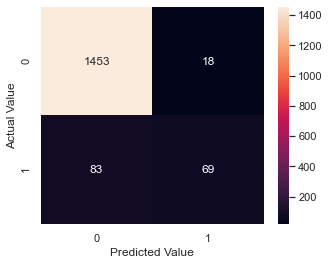

In [173]:
plt.figure(figsize=(5,4))
sns.heatmap(cmGrid, annot=True, fmt='g')
plt.xlabel('Predicted Value')
plt.ylabel('Actual Value')

In [114]:
from sklearn.metrics import confusion_matrix
y_true = y_test
y_pred = best_clf.best_estimator_.predict_proba(X_test)
print(y_pred)

[[0.69355492 0.30644508]
 [0.71859996 0.28140004]
 [0.72322686 0.27677314]
 ...
 [0.36821146 0.63178854]
 [0.72666605 0.27333395]
 [0.71859996 0.28140004]]


In [115]:
proba_df= pd.DataFrame(y_pred, columns = ['proba_0', 'proba_1'])
proba_df

,proba_0,proba_1
0,0.693555,0.306445
1,0.718600,0.281400
2,0.723227,0.276773
3,0.720069,0.279931
4,0.727807,0.272193
5,0.724376,0.275624
6,0.727807,0.272193
7,0.576249,0.423751
8,0.711885,0.288115
9,0.665684,0.334316


In [116]:
thresh = .60
proba_df['class'] = [1 if proba > thresh else 0 for proba in proba_df['proba_1']]
proba_df

,proba_0,proba_1,class
0,0.693555,0.306445,0
1,0.718600,0.281400,0
2,0.723227,0.276773,0
3,0.720069,0.279931,0
4,0.727807,0.272193,0
5,0.724376,0.275624,0
6,0.727807,0.272193,0
7,0.576249,0.423751,0
8,0.711885,0.288115,0
9,0.665684,0.334316,0


In [117]:
cm_Grid = confusion_matrix(y_true, proba_df['class'])
cm_Grid

array([[1466,    5],
       [ 109,   43]], dtype=int64)

Text(21.5, 0.5, 'Actual Value')

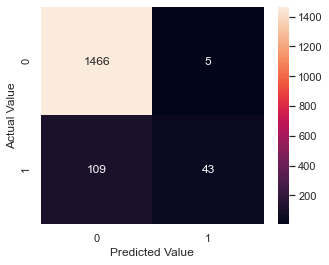

In [172]:
plt.figure(figsize=(5,4))
sns.heatmap(cm_Grid, annot=True, fmt='g')
plt.xlabel('Predicted Value')
plt.ylabel('Actual Value')

Lasso Modeling (we go from 35 features and end up with 17 features)

In [119]:
# Train model
logit = LogisticRegression(solver='liblinear', max_iter=100, penalty='l1', random_state=1, C=0.5)

clf_1 = logit.fit(X_train, y_train)
 
# Predict on training set
pred_y_1 = clf_1.predict(X_train)

print(clf_1.score(X_train, y_train))
print(clf_1.score(X_test, y_test))

# auc_train = roc_auc_score(y_train, clf_1.predict_proba(X_train)[:, 1])
# auc_test = roc_auc_score(y_test, clf_1.predict_proba(X_test)[:, 1])
# print(auc_train)
# print(auc_test)

# C = 0.1
# 0.8756163155535635
# 0.9328404189772027

# C = 0.5
# 0.8785298072613178
# 0.9303758471965496

0.8785298072613178
0.9303758471965496


In [120]:
clf_1.coef_

array([[ 0.20756383, -0.10391489,  0.23971197,  0.        , -0.09836187,
         0.02080851, -3.62771079,  4.36855273,  0.        ,  1.74665834,
         0.02794713,  0.        ,  0.2405314 ,  0.33698824, -1.12769059,
         0.05078695,  0.        ,  0.        ,  0.07695184,  0.        ,
         0.        ,  0.01390509,  0.        , -0.46284187,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        , -0.34229504,  0.        ]])

In [121]:
display = pd.DataFrame(clf_1.coef_,
                   columns=X_train.columns)
display = display.T
display.columns = ["coef"]
display=display.reset_index()
display = display.rename(columns={"index": "Features"})
keep=display[display["coef"]!=0].sort_values(by='coef', ascending=False)
keep

,Features,coef
7,Unique_DiagnosisGroupCode,4.368553
9,Unique_ClmAdmitDiagnosisCode,1.746658
13,Claim_count,0.336988
12,Avg_TotalClaimCost,0.240531
2,Avg_AdmissionDuration,0.239712
0,Unique_County,0.207564
18,ChronicCond_KidneyDisease,0.076952
15,RenalDiseaseIndicator,0.050787
10,Avg_Total_Physician,0.027947
5,Avg_Total_ClmDiagnosisCode,0.020809


In [122]:
# DiagnosisGroupCode_count, Avg_ClaimDuration, 'Age_70-80'
vif_data.sort_values(by="VIF", ascending=False)

,feature,VIF
6,ClmAdmitDiagnosisCode_count,287.743120
1,Claim_count,208.465743
2,Avg_TotalClaimCost_PerPatient,205.045053
3,Avg_TotalClaimCost,204.497585
8,DiagnosisGroupCode_count,132.193342
7,Unique_DiagnosisGroupCode,113.102959
4,Avg_Total_Physician,54.018093
5,Unique_ClmAdmitDiagnosisCode,35.819830
31,ChronicCond_IschemicHeart,31.339750
30,ChronicCond_Diabetes,23.007966


In [123]:
from sklearn.metrics import confusion_matrix
y_true = y_test 
y_pred = clf_1.predict(X_test) 
cm_Lasso = confusion_matrix(y_true, y_pred)
cm_Lasso

# Lasso (C-0.1)
# array([[1426,   45],
#        [  64,   88]], dtype=int64)

array([[1414,   57],
       [  56,   96]], dtype=int64)

In [175]:
96/(96+56)

# Lasso (C=0.1)
# 0.5789473684210527

0.631578947368421

Text(21.5, 0.5, 'Actual Value')

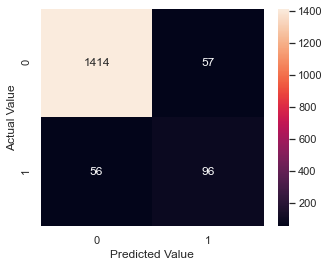

In [171]:
plt.figure(figsize=(5,4))
sns.heatmap(cm_Lasso, annot=True, fmt='g')
plt.xlabel('Predicted Value')
plt.ylabel('Actual Value')

In [126]:
final1.shape

(5410, 37)

In [127]:
EDA_1 = final1[['Provider','PotentialFraud','Claim_count', 'Avg_TotalClaimCost_PerPatient','Avg_TotalClaimCost', 'Avg_Total_Physician', 'ClmAdmitDiagnosisCode_count', 'DiagnosisGroupCode_count', 'Avg_Total_ClmDiagnosisCode', 'Avg_Total_ClmProcedureCode','Avg_ClaimDuration','Avg_AdmissionDuration']]
EDA_1.head()

,Provider,PotentialFraud,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,ClmAdmitDiagnosisCode_count,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration
0,PRV51001,0,25,1145.083333,1121.080000,1.600000,11,5,3.200000,0.120000,2.440000,2.000000
1,PRV51003,1,132,1382.559829,1368.287879,1.530303,78,62,5.250000,0.363636,4.674242,3.424242
2,PRV51004,0,149,352.415459,352.214765,1.604027,28,0,2.583893,0.000000,2.429530,1.000000
3,PRV51005,1,1165,256.429705,244.300429,1.599142,252,0,2.588841,0.000000,2.088412,1.000000
4,PRV51007,0,72,234.129310,257.458333,1.527778,17,3,2.986111,0.013889,1.958333,1.222222


In [128]:
EDA_1.shape

(5410, 12)

Write to a csv file in order to do EDA in a separate Jupyter notebook:

In [129]:
EDA_1.to_csv('./EDA_1.csv')

In [130]:
final1.columns

Index(['Provider', 'Unique_patients', 'Claim_count',
       'Avg_TotalClaimCost_PerPatient', 'Avg_TotalClaimCost',
       'Avg_Total_Physician', 'Unique_ClmAdmitDiagnosisCode',
       'ClmAdmitDiagnosisCode_count', 'Unique_DiagnosisGroupCode',
       'DiagnosisGroupCode_count', 'Avg_Total_ClmDiagnosisCode',
       'Avg_Total_ClmProcedureCode', 'Avg_ClaimDuration',
       'Avg_AdmissionDuration', 'Unique_States', 'Unique_County',
       'PotentialFraud', 'Age_20-30', 'Age_30-40', 'Age_40-50', 'Age_50-60',
       'Age_60-70', 'Age_70-80', 'Age_80-90', 'Age_90-101',
       'RenalDiseaseIndicator', 'ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke'],
      dtype='object')

In [131]:
final1.head()

,Provider,Unique_patients,Claim_count,Avg_TotalClaimCost_PerPatient,Avg_TotalClaimCost,Avg_Total_Physician,Unique_ClmAdmitDiagnosisCode,ClmAdmitDiagnosisCode_count,Unique_DiagnosisGroupCode,DiagnosisGroupCode_count,Avg_Total_ClmDiagnosisCode,Avg_Total_ClmProcedureCode,Avg_ClaimDuration,Avg_AdmissionDuration,Unique_States,Unique_County,PotentialFraud,Age_20-30,Age_30-40,Age_40-50,Age_50-60,Age_60-70,Age_70-80,Age_80-90,Age_90-101,RenalDiseaseIndicator,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke
0,PRV51001,24,25,1145.083333,1121.080000,1.600000,12,11,5,5,3.200000,0.120000,2.440000,2.000000,1,7,0,0.00,0.00,0.00,0.08,0.12,0.29,0.25,0.25,0.33,0.58,0.75,0.71,0.21,0.38,0.38,0.83,0.92,0.25,0.33,0.21
1,PRV51003,117,132,1382.559829,1368.287879,1.530303,59,78,58,62,5.250000,0.363636,4.674242,3.424242,3,23,1,0.00,0.02,0.10,0.11,0.16,0.41,0.16,0.03,0.19,0.38,0.60,0.44,0.09,0.28,0.40,0.74,0.85,0.24,0.27,0.08
2,PRV51004,138,149,352.415459,352.214765,1.604027,26,28,0,0,2.583893,0.000000,2.429530,1.000000,9,28,0,0.01,0.00,0.07,0.08,0.20,0.32,0.25,0.08,0.14,0.43,0.59,0.34,0.12,0.27,0.43,0.70,0.71,0.31,0.30,0.12
3,PRV51005,495,1165,256.429705,244.300429,1.599142,159,252,0,0,2.588841,0.000000,2.088412,1.000000,4,26,1,0.00,0.03,0.04,0.12,0.24,0.30,0.21,0.05,0.16,0.33,0.53,0.36,0.12,0.21,0.37,0.63,0.70,0.29,0.26,0.08
4,PRV51007,58,72,234.129310,257.458333,1.527778,18,17,3,3,2.986111,0.013889,1.958333,1.222222,2,6,0,0.02,0.05,0.03,0.10,0.24,0.34,0.12,0.09,0.16,0.36,0.52,0.29,0.10,0.21,0.36,0.62,0.69,0.29,0.28,0.16


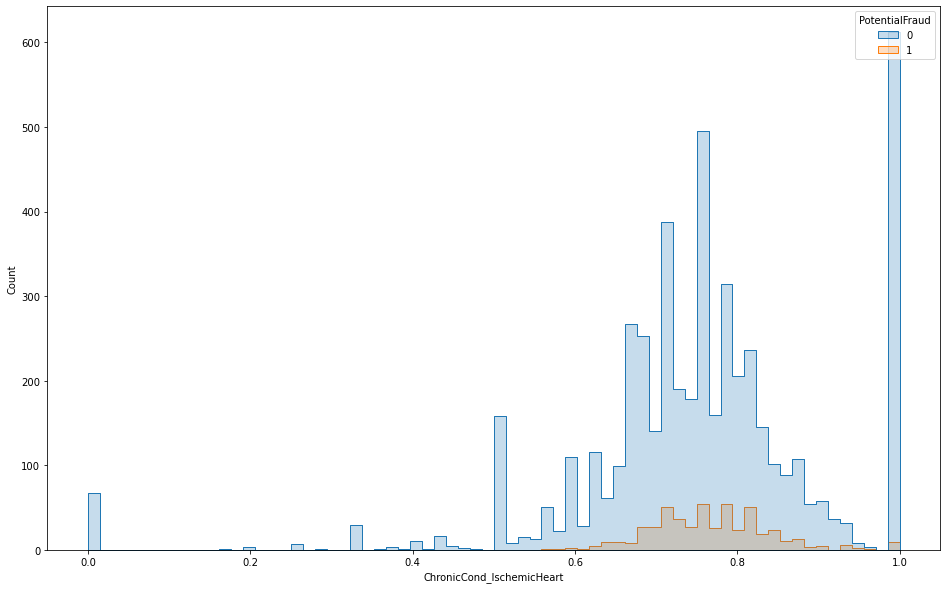

In [132]:
splot = sns.histplot(final1, x="ChronicCond_IschemicHeart", hue="PotentialFraud", element="step", )

splot.autoscale()
# splot.set_xlim(0, 2500)
fig = plt.gcf()
fig.set_size_inches( 16, 10)

In [133]:
final1_corr=final1[['ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke', 'RenalDiseaseIndicator']]
final1_corr = final1_corr.corr(method ='pearson')
final1_corr[['ChronicCond_Alzheimer']].sort_values(by ='ChronicCond_Alzheimer' )

,ChronicCond_Alzheimer
ChronicCond_Cancer,0.087943
ChronicCond_Osteoporasis,0.101994
ChronicCond_rheumatoidarthritis,0.121661
ChronicCond_Depression,0.136633
RenalDiseaseIndicator,0.137420
ChronicCond_stroke,0.157092
ChronicCond_ObstrPulmonary,0.171232
ChronicCond_IschemicHeart,0.174762
ChronicCond_Diabetes,0.190995
ChronicCond_Heartfailure,0.222260


In [134]:
final1_corr[['ChronicCond_Cancer']].sort_values(by ='ChronicCond_Cancer' )

,ChronicCond_Cancer
ChronicCond_Osteoporasis,0.022134
ChronicCond_Depression,0.026248
ChronicCond_rheumatoidarthritis,0.028407
RenalDiseaseIndicator,0.057126
ChronicCond_stroke,0.057176
ChronicCond_Alzheimer,0.087943
ChronicCond_IschemicHeart,0.103726
ChronicCond_Heartfailure,0.116365
ChronicCond_Diabetes,0.120322
ChronicCond_KidneyDisease,0.122266


In [135]:
final1_corr_all = final1.corr(method ='pearson')
final1_corr_all[['Unique_States']].sort_values(by ='Unique_States') 

,Unique_States
Avg_AdmissionDuration,-0.040290
Avg_Total_ClmDiagnosisCode,-0.039830
Avg_Total_ClmProcedureCode,-0.037685
Avg_TotalClaimCost_PerPatient,-0.030448
Avg_TotalClaimCost,-0.030297
Avg_ClaimDuration,-0.020927
Age_50-60,-0.019139
ChronicCond_IschemicHeart,-0.011806
Avg_Total_Physician,-0.010689
ChronicCond_ObstrPulmonary,-0.009476


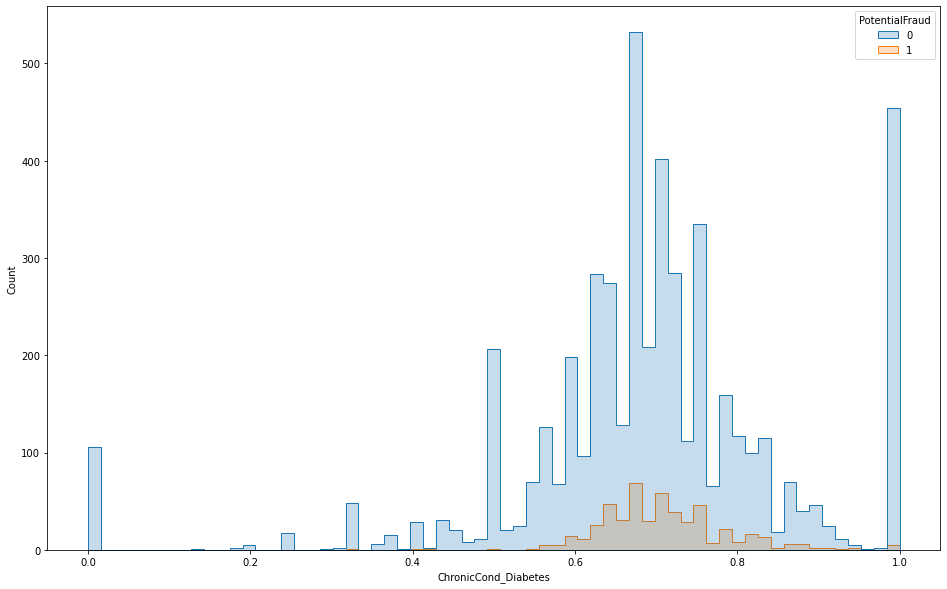

In [136]:
splot = sns.histplot(final1, x="ChronicCond_Diabetes", hue="PotentialFraud", element="step", )

splot.autoscale()
# splot.set_xlim(0, 2500)
fig = plt.gcf()
fig.set_size_inches( 16, 10)

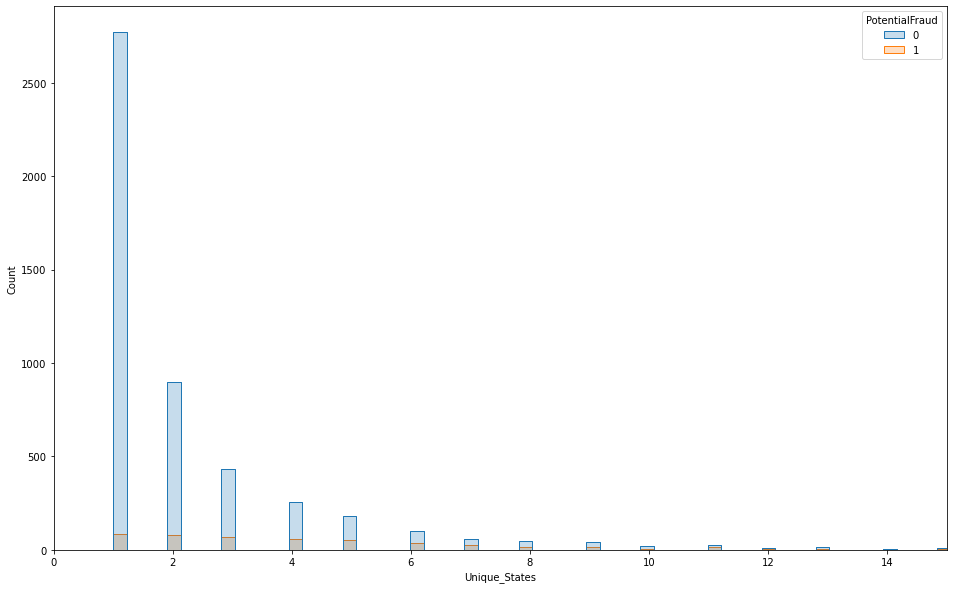

In [137]:
splot = sns.histplot(final1, x="Unique_States", hue="PotentialFraud", element="step", )

splot.autoscale()
splot.set_xlim(0, 15)
fig = plt.gcf()
fig.set_size_inches( 16, 10)

In [138]:
final1.shape

(5410, 37)

In [139]:
len(final1.loc[final1['Avg_Total_Physician'] ==0])

0

In [140]:
X_train.shape

(4462, 35)

In [141]:
X_train.columns

Index(['Unique_County', 'Unique_States', 'Avg_AdmissionDuration',
       'Avg_ClaimDuration', 'Avg_Total_ClmProcedureCode',
       'Avg_Total_ClmDiagnosisCode', 'DiagnosisGroupCode_count',
       'Unique_DiagnosisGroupCode', 'ClmAdmitDiagnosisCode_count',
       'Unique_ClmAdmitDiagnosisCode', 'Avg_Total_Physician',
       'Avg_TotalClaimCost_PerPatient', 'Avg_TotalClaimCost', 'Claim_count',
       'Unique_patients', 'RenalDiseaseIndicator', 'ChronicCond_Alzheimer',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_Cancer', 'ChronicCond_ObstrPulmonary',
       'ChronicCond_Depression', 'ChronicCond_Diabetes',
       'ChronicCond_IschemicHeart', 'ChronicCond_Osteoporasis',
       'ChronicCond_rheumatoidarthritis', 'ChronicCond_stroke', 'Age_20-30',
       'Age_30-40', 'Age_40-50', 'Age_50-60', 'Age_60-70', 'Age_70-80',
       'Age_80-90', 'Age_90-101'],
      dtype='object')

In [142]:
list(keep.Features)

['Unique_DiagnosisGroupCode',
 'Unique_ClmAdmitDiagnosisCode',
 'Claim_count',
 'Avg_TotalClaimCost',
 'Avg_AdmissionDuration',
 'Unique_County',
 'ChronicCond_KidneyDisease',
 'RenalDiseaseIndicator',
 'Avg_Total_Physician',
 'Avg_Total_ClmDiagnosisCode',
 'ChronicCond_Depression',
 'Avg_Total_ClmProcedureCode',
 'Unique_States',
 'Age_80-90',
 'ChronicCond_IschemicHeart',
 'Unique_patients',
 'DiagnosisGroupCode_count']

In [143]:
X_train_lasso1 = X_train[['Unique_DiagnosisGroupCode',
 'Unique_ClmAdmitDiagnosisCode',
 'Claim_count',
 'Avg_TotalClaimCost',
 'Avg_AdmissionDuration',
 'Unique_County',
 'ChronicCond_KidneyDisease',
 'RenalDiseaseIndicator',
 'Avg_Total_Physician',
 'Avg_Total_ClmDiagnosisCode',
 'ChronicCond_Depression',
 'Avg_Total_ClmProcedureCode',
 'Unique_States',
 'Age_80-90',
 'ChronicCond_IschemicHeart',
 'Unique_patients',
 'DiagnosisGroupCode_count']]
X_train_lasso1.head()

,Unique_DiagnosisGroupCode,Unique_ClmAdmitDiagnosisCode,Claim_count,Avg_TotalClaimCost,Avg_AdmissionDuration,Unique_County,ChronicCond_KidneyDisease,RenalDiseaseIndicator,Avg_Total_Physician,Avg_Total_ClmDiagnosisCode,ChronicCond_Depression,Avg_Total_ClmProcedureCode,Unique_States,Age_80-90,ChronicCond_IschemicHeart,Unique_patients,DiagnosisGroupCode_count
0,-0.359205,0.010156,0.084094,-0.186070,-0.425291,-0.166326,0.29,0.15,0.238503,-0.537097,0.31,-0.437440,-0.524122,0.27,0.69,-0.078497,-0.336670
1,-0.359205,-0.431924,-0.301789,-0.465335,-0.425291,0.025710,0.21,0.05,1.152152,0.187966,0.47,-0.437440,-0.182495,0.26,0.89,-0.342085,-0.336670
2,-0.359205,-0.376664,-0.279947,-0.414241,-0.425291,0.217745,0.30,0.17,-0.074590,-0.283265,0.43,-0.437440,0.159131,0.35,0.74,-0.312797,-0.336670
3,-0.359205,-0.376664,-0.221700,-0.221239,-0.425291,-0.742434,0.58,0.37,-0.282471,-0.814006,0.42,-0.437440,-0.524122,0.29,0.79,-0.202969,-0.336670
4,0.414753,0.341716,-0.065163,0.132835,-0.002242,0.217745,0.52,0.27,-0.697879,-0.182171,0.45,0.223641,0.159131,0.25,0.82,-0.041888,0.341722


In [144]:
X_train_lasso1.shape

(4462, 17)

In [145]:
X_test_lasso1 = X_test[['Unique_DiagnosisGroupCode',
 'Unique_ClmAdmitDiagnosisCode',
 'Claim_count',
 'Avg_TotalClaimCost',
 'Avg_AdmissionDuration',
 'Unique_County',
 'ChronicCond_KidneyDisease',
 'RenalDiseaseIndicator',
 'Avg_Total_Physician',
 'Avg_Total_ClmDiagnosisCode',
 'ChronicCond_Depression',
 'Avg_Total_ClmProcedureCode',
 'Unique_States',
 'Age_80-90',
 'ChronicCond_IschemicHeart',
 'Unique_patients',
 'DiagnosisGroupCode_count']]
X_test_lasso1.head()

,Unique_DiagnosisGroupCode,Unique_ClmAdmitDiagnosisCode,Claim_count,Avg_TotalClaimCost,Avg_AdmissionDuration,Unique_County,ChronicCond_KidneyDisease,RenalDiseaseIndicator,Avg_Total_Physician,Avg_Total_ClmDiagnosisCode,ChronicCond_Depression,Avg_Total_ClmProcedureCode,Unique_States,Age_80-90,ChronicCond_IschemicHeart,Unique_patients,DiagnosisGroupCode_count
1510,-0.316860,0.212225,0.006848,-0.163324,-0.445075,1.230256,0.33,0.16,-0.167511,-0.465298,0.39,-0.442658,0.100900,0.24,0.75,0.201803,-0.279755
2536,-0.316860,-0.344437,-0.270251,-0.189477,-0.445075,-0.266261,0.50,0.41,-0.116387,-0.421733,0.41,-0.442658,0.100900,0.14,0.73,-0.310647,-0.279755
1031,-0.316860,-0.450468,-0.348887,-0.501943,-0.445075,-0.442321,0.33,0.25,-0.513414,-0.502308,0.50,-0.442658,-0.500056,0.42,0.67,-0.374704,-0.279755
667,-0.224937,-0.529991,-0.390078,4.507586,1.733985,-0.706413,0.50,0.00,1.684085,3.270214,1.00,3.867275,-0.500056,0.00,1.00,-0.438760,-0.205825
3710,-0.316860,-0.556499,-0.390078,-0.689369,-0.445075,-0.706413,0.00,0.00,-0.356450,-0.232842,0.50,-0.442658,-0.500056,0.50,1.00,-0.438760,-0.279755


In [146]:
X_test_lasso1.shape

(1623, 17)

In [169]:
display=display.sort_values(by='coef', ascending=False)
display

,Features,coef
7,Unique_DiagnosisGroupCode,4.368553
9,Unique_ClmAdmitDiagnosisCode,1.746658
13,Claim_count,0.336988
12,Avg_TotalClaimCost,0.240531
2,Avg_AdmissionDuration,0.239712
0,Unique_County,0.207564
18,ChronicCond_KidneyDisease,0.076952
15,RenalDiseaseIndicator,0.050787
10,Avg_Total_Physician,0.027947
5,Avg_Total_ClmDiagnosisCode,0.020809


This shows the final important features Lasso ended up with through feature selection and we use AUC_ROC score as well as Recall utilizing Confusion matrix to compare and evaluate models for Model Selection

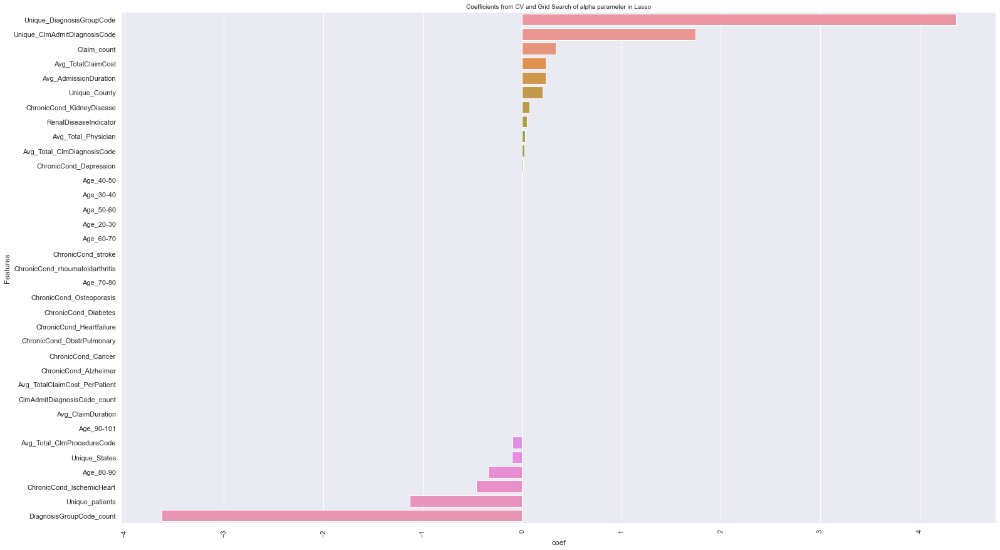

In [170]:
sns.set(rc={'figure.figsize':(25,15)})
sns.barplot(y='Features', x='coef', data=display)
plt.title('Coefficients from CV and Grid Search of alpha parameter in Lasso', size =10) # C=0.5 
plt.xticks(rotation = 90)
plt.show()
